In [122]:
import matplotlib.pyplot as plt
import numpy as np
import math

In [123]:
def f(x):
    # Funición a evaluar
    a = (np.e**(-x[0]**2 - x[1]**2))*x[0]
    return a


def grad(x):
    """ Retorna gradiente f"""
    list1 = [1-2*x[0]**2, -2*x[0]*x[1]]
    descenso = np.array(list1)*math.e**(-x[0]**2 - x[1]**2)
    return descenso


def hessiano(x):
    """Evalua la matriz Hessiana, ingresar derivadas"""
    axax = (2*x[0]*((2*x[0]**2)-3))*math.e**(-(x[0]**2) - (x[1]**2))
    ayay = (2*x[0]*((2*x[1]**2) - 1))*math.e**(-(x[0]**2) - (x[1]**2))
    axay = 2*(2*x[0]**2 - 1)*x[1]*math.e**(-x[0]**2 - x[1]**2)
    # return axay
    return np.array([
        [axax, axay],
        [axay, ayay]
    ])


def dirgrad(x):
    """Retorna la dirección del gradiente p"""
    vgrad = grad(x)
    magGrad = np.sqrt(vgrad.dot(vgrad))
    p = -vgrad/magGrad
    return p


def phiAlpha(x0, alpha, p):
    paX = x0 + p * alpha
    return f(paX)


def phipAlpha(x0, alpha, p):
    x = x0 + alpha * p
    vgrad = grad(x)
    return (np.dot(vgrad, p))


def phipp(x0, alpha, p):
    x = x0 + alpha * p
    ahess = hessiano(x)
    return np.dot(np.dot(ahess, p), p)


# Exhaustivo Refinado

In [124]:
def exhaustivoRefinado(p, xini, alpha=0, h=0.1, tol=1e-6):
    """Busqueda de minimo con metodo exhaustivo refinado. puedes cambiar el paso
    Retorna f(a) y alpha
    """
    k = 0
    while h > tol:
        while phiAlpha(xini, alpha+h, p) < phiAlpha(xini, alpha, p):
            alpha = alpha + h
            fnow = phiAlpha(xini, alpha, p)
            print(k, h, fnow)
            k += 1
        alpha = alpha-h
        h = h / 10
    return alpha


In [125]:
x0 = [-.5, -.5]
p = dirgrad(x0)
exhaustivoRefinado(p,x0)

0 0.1 -0.3427092389912024
1 0.1 -0.37378717438264636
2 0.1 -0.3947542169770023
3 0.1 -0.40461330063960843
4 0.01 -0.39624939425929684
5 0.01 -0.39763225197706237
6 0.01 -0.3989023235942036
7 0.01 -0.4000592268019067
8 0.01 -0.40110266355111684
9 0.01 -0.402032419987818
10 0.01 -0.40284836629166737
11 0.01 -0.403550456418686
12 0.01 -0.40413872774885506
13 0.01 -0.40461330063960843
14 0.01 -0.4049743778863538
15 0.01 -0.4052222440912936
16 0.01 -0.4053572649419525
17 0.01 -0.4053798864009474
18 0.001 -0.4053645770113837
19 0.001 -0.40537076551125595
20 0.001 -0.405375830939353
21 0.001 -0.4053797738013786
22 0.001 -0.4053825946109471
23 0.001 -0.40538429388957375
24 0.001 -0.40538487216666497
25 0.0001 -0.4053844021535485
26 0.0001 -0.40538449920803504
27 0.0001 -0.40538458505356806
28 0.0001 -0.40538465969068277
29 0.0001 -0.40538472311991547
30 0.0001 -0.4053847753418028
31 0.0001 -0.40538481635688256
32 0.0001 -0.4053848461656932
33 0.0001 -0.405384864768774
34 0.0001 -0.405384872166

0.43701500000000004

## Busqueda Exhaustiva.

In [126]:
def exhaustiva(p, xini, alpha=0, h=0.00001, tol=1e-9):
    """Busqueda de minimo con metodo exhaustivo refinado. puedes cambiar el paso
    Retorna f(a) y alpha
    """
    k = 0
    # while h > tol:
    while phiAlpha(xini, alpha+h, p) < phiAlpha(xini, alpha, p):
        alpha = alpha + h
        k += 1
        print(k, alpha, phiAlpha(xini, alpha, p))
    return alpha


In [127]:
x0 = [-.5, -.5]
p = dirgrad(x0)
alphaE = exhaustiva(p, x0, h=0.001)
xfin = x0 + alphaE * p
print(phipAlpha(x0, alphaE, p))
print(phipp(x0, alphaE, p))


1 0.001 -0.3036939081047371
2 0.002 -0.30412187725133544
3 0.003 -0.30454923472831097
4 0.004 -0.3049759779715534
5 0.005 -0.305402104420669
6 0.006 -0.3058276115190055
7 0.007 -0.3062524967136781
8 0.008 -0.30667675745559503
9 0.009000000000000001 -0.30710039119948274
10 0.010000000000000002 -0.30752339540391166
11 0.011000000000000003 -0.30794576753132147
12 0.012000000000000004 -0.3083675050480463
13 0.013000000000000005 -0.3087886054243405
14 0.014000000000000005 -0.3092090661344035
15 0.015000000000000006 -0.30962888465640537
16 0.016000000000000007 -0.3100480584725116
17 0.017000000000000008 -0.3104665850689089
18 0.01800000000000001 -0.3108844619358298
19 0.01900000000000001 -0.3113016865675779
20 0.02000000000000001 -0.3117182564625529
21 0.02100000000000001 -0.3121341691232759
22 0.022000000000000013 -0.3125494220564136
23 0.023000000000000013 -0.3129640127728042
24 0.024000000000000014 -0.3133779387874814
25 0.025000000000000015 -0.31379119761969976
26 0.026000000000000016 -0

## Máximo Descenso 

In [128]:
def maximoDescenso(xini, p):
    """Regresa alpha maximo descenso """
    vgrad = grad(xini)
    amaxDes = -np.dot(vgrad, p) / \
        np.dot(np.dot(hessiano(xini), p), p)
    return amaxDes


In [129]:
x0 = [-.5, -.5]
p = dirgrad(x0)
print("Alfa de maximo descenso: ")
alphaMD = maximoDescenso(x0,p)
print(alphaMD)

print("Phi de alpha: ")
print(f(x0+alphaMD*p))

print(phipAlpha(x0, alphaMD, p))
print(phipp(x0, alphaMD, p))


Alfa de maximo descenso: 
0.7071067811865476
Phi de alpha: 
-0.36787944117144233
0.26013004751144453
0.7357588823428846


## Razon Dorada


In [130]:
tol = 1e-6
R = (-1 + 5 ** 0.5) / 2
def razonDorada(xl, xu):
    print(f"<=== Calculado con Tol: {tol}  ===>\n")
    k = 0
    i = 1
    d = R*(xu - xl)
    x1 = xl + d
    x2 = xu - d
    fxl = f(xl)
    fxu = f(xu)
    fx1 = f(x1)
    fx2 = f(x2)
    # print(f'k:{k}   xl:{ xl }  f(xl): { fxl }   x2:{ x2 }  f(x2):{ fx2 }  x1:{ x1 }   f(x1):{ fx1 }   xu:{ xu }   f(xu):{ fxu }   d:{ d }')
    imprimir(xl, xu, k, d, x1, x2, fxl, fxu, fx1, fx2)
    k = k + 1

    while np.all(xu-xl) > tol:

        if fx1 < fx2:
            xl = x2
            fxl = fx2
            x2 = x1
            fx2 = fx1
            d = d * R
            x1 = xl + d
            fx1 = f(x1)
            imprimir(xl, xu, k, d, x1, x2, fxl, fxu, fx1, fx2)
        elif fx2 < fx1:
            xu = x1
            fxu = fx1
            x1 = x2
            fx1 = fx2
            d = d * R
            x2 = xu - d
            fx2 = f(x2)
            imprimir(xl, xu, k, d, x1, x2, fxl, fxu, fx1, fx2)
        k = k+1
        i = i+1

    if fx1 < fx2:
        print(
            f"Mínimo encontrado con Tol = {tol}  x: {x1}   f(x): { f(x1) }   f\'(x): { grad(x1) }")
    elif fx2 < fx1:
        print(
            f"Mínimo encontrado con Tol = {tol}  x: {  x2  }   f(x): { f(x2) }   f\'(x): { grad(x2) }")


def imprimir(xl, xu, k, d, x1, x2, fxl, fxu, fx1, fx2):
    print(f'k:{k}   xl:{ xl }  f(xl): { fxl }   x2:{ x2 }  f(x2):{ fx2 }  x1:{ x1 }   f(x1):{ fx1 }   xu:{ xu }   f(xu):{ fxu }   d:{ d }')
    if fx1 > fx2:
        print(
            f' x: { x1 } f(x): { f(x1) }   f\'(x): { grad(x1) }')
    elif fx2 > fx1:
        print(
            f' x: { x2 } f(x): { f(x2) }   f\'(x): { grad(x2) }')


In [131]:
x0 = [-.5, -.5]
p = dirgrad(x0)
alpha = razonDorada(x0, x0+alphaMD*p)
print()
print("F(x): ", alpha)

<=== Calculado con Tol: 1e-06  ===>

k:0   xl:[-0.5, -0.5]  f(xl): -0.3032653298563167   x2:[-0.69098301 -0.30901699]  f(x2):-0.389617782114498  x1:[-0.80901699 -0.19098301]   f(x1):-0.40538487231052245   xu:[-1.00000000e+00  1.11022302e-16]   f(xu):-0.36787944117144233   d:[-0.30901699  0.30901699]
 x: [-0.69098301 -0.30901699] f(x): -0.389617782114498   f'(x): [ 0.02542162 -0.24079703]
k:1   xl:[-0.69098301 -0.30901699]  f(xl): -0.389617782114498   x2:[-0.80901699 -0.19098301]  f(x2):-0.40538487231052245  x1:[-0.88196601 -0.11803399]   f(x1):-0.39955740690479663   xu:[-1.00000000e+00  1.11022302e-16]   f(xu):-0.36787944117144233   d:[-0.19098301  0.19098301]
 x: [-0.88196601 -0.11803399] f(x): -0.39955740690479663   f'(x): [-0.25176171 -0.09432271]
k:2   xl:[-0.69098301 -0.30901699]  f(xl): -0.389617782114498   x2:[-0.76393202 -0.23606798]  f(x2):-0.40308948499053  x1:[-0.80901699 -0.19098301]   f(x1):-0.40538487231052245   xu:[-0.88196601 -0.11803399]   f(xu):-0.39955740690479663   

KeyboardInterrupt: 

## Newton

In [ ]:
def newton(x0, p):
    k = 0
    alpha = 0
    tol = 1e-6

    while abs(np.dot(grad(x0), p)) > tol:
        phiprima = np.dot(grad(x0), p)
        phibiprima = np.dot(np.dot(hessiano(x0), p), p)
        alphaNew = alpha - (phiprima/phibiprima)
        print(k, alphaNew, x0)
        k = k+1
        # x0 = x0 + alphaNew*p
        alpha = alphaNew
    return alpha


x0 = [-0.5, -.5]
p = dirgrad(x0)

alphaNewton = newton(x0, p)
print("Alpha de Newton: ")
print(alphaNewton)
print("Phi de alpha: ")
f(x0+alphaNewton*p)


print(phipAlpha(x0, 0.43701500000000004, p))
print(phipp(x0, 0.43701500000000004, p))


0 0.7071067811865476 [-0.5, -0.5]
1 1.4142135623730951 [-0.5, -0.5]
2 2.121320343559643 [-0.5, -0.5]
3 2.8284271247461903 [-0.5, -0.5]
4 3.5355339059327378 [-0.5, -0.5]
5 4.242640687119286 [-0.5, -0.5]
6 4.949747468305834 [-0.5, -0.5]
7 5.6568542494923815 [-0.5, -0.5]
8 6.363961030678929 [-0.5, -0.5]
9 7.071067811865477 [-0.5, -0.5]
10 7.778174593052025 [-0.5, -0.5]
11 8.485281374238573 [-0.5, -0.5]
12 9.192388155425121 [-0.5, -0.5]
13 9.899494936611669 [-0.5, -0.5]
14 10.606601717798217 [-0.5, -0.5]
15 11.313708498984765 [-0.5, -0.5]
16 12.020815280171313 [-0.5, -0.5]
17 12.72792206135786 [-0.5, -0.5]
18 13.435028842544408 [-0.5, -0.5]
19 14.142135623730956 [-0.5, -0.5]
20 14.849242404917504 [-0.5, -0.5]
21 15.556349186104052 [-0.5, -0.5]
22 16.2634559672906 [-0.5, -0.5]
23 16.970562748477146 [-0.5, -0.5]
24 17.677669529663692 [-0.5, -0.5]
25 18.38477631085024 [-0.5, -0.5]
26 19.091883092036785 [-0.5, -0.5]
27 19.79898987322333 [-0.5, -0.5]
28 20.506096654409877 [-0.5, -0.5]
29 21.213

KeyboardInterrupt: 

## Interpolacion Cuadratica

In [ ]:
def interpolacion(x0, p, a1, ao=0):
    phi0 = phiAlpha(x0, ao, p)
    phi1 = phiAlpha(x0, a1, p)
    phip0 = phipAlpha(x0, ao, p)
    return ao - (phip0*(a1-ao)**2)/(2*(phi1-phi0-(phip0*(a1-ao))))


In [ ]:
x0 = [-.5, -.5]
p = dirgrad(x0)
alphaInt = interpolacion(x0, p, alphaMD)
print("Alpha interpolacion:")
print(alphaInt)
print("Phi de alpha: ")
# print(f(x0+alpha*p))
print(phipAlpha(x0, 0.449276, p))
print(phipp(x0, 0.449276, p))


Alpha interpolacion:
0.4492769250268134
Phi de alpha: 
0.013693673677387372
1.1132308776513031


In [ ]:
p = dirgrad(x0)
p

array([-0.70710678,  0.70710678])

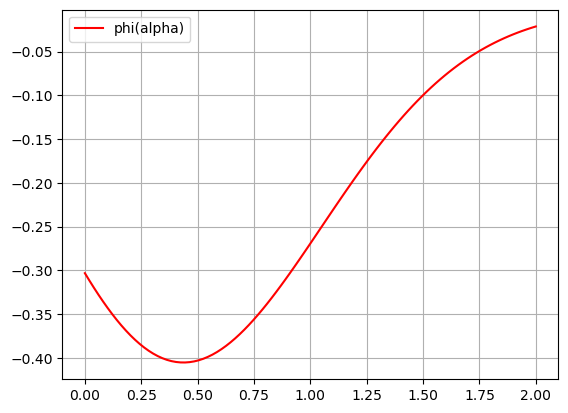

In [ ]:
import matplotlib.pyplot as plt

alpha = np.linspace(0, 2, 100)

x0 = np.array([-.5, -.5])
p = dirgrad(x0)

def puntos(x0, alfa, p):
    x = x0 + p*alfa
    return f(x)


ppts = []
for i in alpha:
    ppts.append(puntos(x0, i, p))


plt.plot(alpha, ppts, 'r', label="phi(alpha)")
plt.legend()
plt.grid()
plt.show()

## Exhaustivo y Newton

In [ ]:
def newton(x0, alpha, p, k):
    tol = 1e-5
    while abs(phipAlpha(x0, alpha, p)) > tol:

        phiprima = phipAlpha(x0, alpha, p)
        phibiprima = phipp(x0, alpha, p)
        alphaNew = alpha - (phiprima/phibiprima)

        print(k, alphaNew, phiprima, phibiprima > 0,
              abs(phipAlpha(x0, alpha, p)))

        alpha = alphaNew
        k += 1

    return alpha


def exhaustivoNewton(x0, p, alpha=0, h=0.1, tol=1e-6):
    """Busqueda de minimo con metodo exhaustivo refinado. puedes cambiar el paso
    Retorna f(a) y alpha
    """
    k = 0
    # while h > tol:
    while phiAlpha(x0, alpha+h, p) < phiAlpha(x0, alpha, p):
        alpha = alpha + h
        k += 1
        print(k, alpha, phiAlpha(x0, alpha, p), phipAlpha(
            x0, alpha, p), phipp(x0, alpha, p) > 0)
    # xNuevo = x0 + alpha * p
    alpha = newton(x0, alpha, p, k)
    return alpha


In [138]:
x0 = [-.5, -.5]
p = dirgrad(x0)
alEN = exhaustivoNewton(x0,p,h=0.01)

print("Alpha Exhaustivo Newton: ")
print(alEN)
print("Phi alpha: ")
print(phiAlpha(x0, alEN, p))

print("phiprima: ")
print(phipAlpha(x0, alEN, p))

print("phi bi prima: ")
print(phipp(x0, alEN, p))



1 0.01 -0.30752339540391166 -0.42268858852236546 True
2 0.02 -0.3117182564625529 -0.4162416937508404 True
3 0.03 -0.31584739751638247 -0.4095452785262274 True
4 0.04 -0.3199083445031667 -0.4026036124883515 True
5 0.05 -0.3238986672847736 -0.395421210035563 True
6 0.060000000000000005 -0.3278159820707266 -0.38800282546193765 True
7 0.07 -0.3316579537914494 -0.3803534477598193 True
8 0.08 -0.3354222984178973 -0.37247829509560226 True
9 0.09 -0.3391067852243459 -0.364382808967229 True
10 0.09999999999999999 -0.3427092389912024 -0.35607264805245376 True
11 0.10999999999999999 -0.34622754214479196 -0.34755368175746826 True
12 0.11999999999999998 -0.34965963683117474 -0.3388319834760209 True
13 0.12999999999999998 -0.35300352692115033 -0.3299138235696665 True
14 0.13999999999999999 -0.35625727994371725 -0.32080566208028105 True
15 0.15 -0.359419028945366 -0.3115141411864371 True
16 0.16 -0.3624869742727057 -0.30204607741568285 True
17 0.17 -0.3654593852760454 -0.2924084536251873 True
18 0.18

## Exhaustivo Refinado y Newton

In [136]:
def newton(x0, alpha, p, k):
    tol = 1e-9
    while abs(phipAlpha(x0, alpha, p)) > tol:

        phiprima = phipAlpha(x0, alpha, p)
        phibiprima = phipp(x0, alpha, p)
        alphaNew = alpha - (phiprima/phibiprima)

        print(k, alphaNew, x0, phiprima, phibiprima,
              abs(phipAlpha(x0, alpha, p)))

        alpha = alphaNew
        k += 1

    return alpha

def exhaustivoRefinadoNewton(p, xini, alpha=0, h=0.1, tol=1e-6):
    """Busqueda de minimo con metodo exhaustivo refinado. puedes cambiar el paso
    Retorna f(a) y alpha
    """
    k = 0
    while h > tol:
        while phiAlpha(xini, alpha+h, p) < phiAlpha(xini, alpha, p):
            alpha = alpha + h
            print(k, alpha, phiAlpha(x0, alpha, p), phipAlpha(
                x0, alpha, p), phipp(x0, alpha, p) > 0)
            k += 1
        alpha = alpha-h
        h = h / 10
    alpha = newton(xini, alpha, p, k)
    return alpha


In [139]:
x0 = [-.5, -.5]
p = dirgrad(x0)
alERN = exhaustivoRefinadoNewton(p, x0, h=0.001)

print("Alpha Exhaustivo Refinado Newton: ")
print(alERN)
print("Phi alpha: ")
print(phiAlpha(x0, alERN, p))

print("phiprima: ")
print(phipAlpha(x0, alERN, p))

print("phi bi prima: ")
print(phipp(x0, alERN, p))

0 0.001 -0.3036939081047371 -0.42827412578241586 True
1 0.002 -0.30412187725133544 -0.42766373944700914 True
2 0.003 -0.30454923472831097 -0.42705078715187095 True
3 0.004 -0.3049759779715534 -0.4264352726003979 True
4 0.005 -0.305402104420669 -0.4258171995216091 True
5 0.006 -0.3058276115190055 -0.42519657167010827 True
6 0.007 -0.3062524967136781 -0.42457339282604484 True
7 0.008 -0.30667675745559503 -0.4239476667950768 True
8 0.009000000000000001 -0.30710039119948274 -0.423319397408331 True
9 0.010000000000000002 -0.30752339540391166 -0.42268858852236546 True
10 0.011000000000000003 -0.30794576753132147 -0.42205524401912786 True
11 0.012000000000000004 -0.3083675050480463 -0.42141936780591777 True
12 0.013000000000000005 -0.3087886054243405 -0.420780963815345 True
13 0.014000000000000005 -0.3092090661344035 -0.42014003600529015 True
14 0.015000000000000006 -0.30962888465640537 -0.41949658835886316 True
15 0.016000000000000007 -0.3100480584725116 -0.4188506248843625 True
16 0.0170000